# Jupyter notebook accompany synaptic nanocolumn analysis for multi-ExR manuscript

Last edited by M. Schroeder on 6.1.23

In [1]:
#import relevant packages
import os
import numpy as np
#from skimage import io
import matplotlib.pyplot as plt
import pickle
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import robust_scale
from sklearn.cluster import KMeans
import scanpy as sc
import anndata
#import leidenalg
#import igraph as ig
from scipy.stats import ttest_ind

In [2]:
def unique(list1): 
    # insert the list to the set 
    list_set = set(list1) 
    # convert the set to the list 
    unique_list = (list(list_set))
    return unique_list

In [3]:
filenames = os.listdir()
csvs = [filename for filename in filenames if filename.endswith('csv') and 'all' in filename]

In [4]:
csvs

[]

In [5]:
os.getcwd()

'/Users/margaret/Dropbox (MIT)/mExR_analysis/Scripts/Python'

In [6]:
parentdir = '/Users/margaret/Dropbox (MIT)/mExR_analysis/SmallData/2022.08_synapses/nanocolumn_data/'

In [7]:
os.listdir(parentdir)

['ROI5_AtoB_Enrichment_refAlign.txt',
 'autocorrelation_curve_non-reference.pdf',
 '.DS_Store',
 'archive',
 'autocorrelation_curve_non-reference.png',
 'ROI3_AtoB_Enrichment_refAlign.txt',
 'ROI2_AtoB_Enrichment_refAlign.txt',
 'enrichment_index_pairwise.csv',
 'ROI1_AtoB_Enrichment_refAlign.txt',
 'nanocolumn_rois_to_exclude.csv',
 'AutoCorrelation_ROI1.txt',
 'AutoCorrelation_ROI3.txt',
 'autocorrelation_curve_all.png',
 'nanocolumn_rois_to_exclude.xlsx',
 'AutoCorrelation_ROI2.txt',
 'autocorrelation_curve_reference.png',
 'AutoCorrelation_ROI5.txt',
 'AutoCorrelation_ROI4.txt',
 'ROI4_AtoB_Enrichment_refAlign.txt']

Define dictionary of channels

In [8]:
channel_dict = {
    1: "Bassoon",2: "SynGAP",3:'NR1',4:'Ref-Homer-1', #1
    5:'Shank3',6: 'GluA1', 7:'CaMKIIa',8:'Ref-Homer-2', #2
    9:'Cav2.1',10: 'NR2B', 11:'RIM1',12:'Ref-Homer-3', #3
    13:'PSD95',14:'Gephyrin',15:'Ref-Homer-4', #4
    16:'Vglut',17:'Vgat',18:'Ref-Homer-5', #5
    19:'mGluR5',20:'PSD95-6',21:'Ref-Homer-6', #6
    22:'RIM-BP',23:'Adam22',24:'Ref-Homer-7',#7
    25:'GluA3',26:'Stargazin',27:'Ref-Homer-8',#8
    28:'Synapsin',29:'GABA-B',30:'Ref-Homer-9',#9
    31:'Synaptophysin',32:'NR1-10',33:'Ref-Homer-10',#10
    34:'GluA4',35:'GluA2',36:'Ref-Homer-11'#11
}

## 1) Load and analyze nanoclumn auto-correlation data

In [9]:
auto_data1 = pd.read_csv(parentdir + 'AutoCorrelation_ROI1.txt',sep='\t',header=None)
auto_data2 = pd.read_csv(parentdir + 'AutoCorrelation_ROI2.txt',sep='\t',header=None)
auto_data3 = pd.read_csv(parentdir + 'AutoCorrelation_ROI3.txt',sep='\t',header=None)
auto_data4 = pd.read_csv(parentdir + 'AutoCorrelation_ROI4.txt',sep='\t',header=None)
auto_data5 = pd.read_csv(parentdir + 'AutoCorrelation_ROI5.txt',sep='\t',header=None)

In [10]:
auto_data2[0] = [2.0]*len(auto_data2)
auto_data3[0] = [3.0]*len(auto_data3)
auto_data4[0] = [4.0]*len(auto_data4)
auto_data5[0] = [5.0]*len(auto_data5)

In [11]:
columns = ['ROI_no','synapse_no','ch_1','x_shift','y_shift','z_shift','avg_int_ch1','avg_int_ch2',
          '1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22']

In [12]:
auto_data = pd.concat((auto_data1,auto_data2,auto_data3,auto_data4,auto_data5), axis=0)
auto_data.columns = columns

In [13]:
auto_data.dropna(how='all',inplace=True,axis=1)

In [14]:
auto_data['synID'] = auto_data['ROI_no'].astype(str) + "-" + auto_data['synapse_no'].astype(str)

In [15]:
auto_data

,ROI_no,synapse_no,ch_1,x_shift,y_shift,z_shift,avg_int_ch1,avg_int_ch2,1,2,...,13,14,15,16,17,18,19,20,21,synID
0,1.0,1.0,1.0,0.0,0.0,0.0,1.5700819e+00,1.5700819e+00,1.4627679e+00,1.4837622e+00,...,1.2405643e+00,1.2827217e+00,1.3240428e+00,1.3440191e+00,1.4016166e+00,1.4603253e+00,1.5220049e+00,1.6121251e+00,1.6507317e+00,1.0-1.0
1,1.0,1.0,2.0,0.0,0.0,0.0,1.9538221e+00,1.9538221e+00,1.4511176e+00,1.4861776e+00,...,1.1034181e+00,1.1164302e+00,1.1333380e+00,1.1415474e+00,1.1591849e+00,NaN,NaN,NaN,NaN,1.0-1.0
2,1.0,1.0,3.0,0.0,0.0,0.0,1.7961312e+00,1.7961312e+00,1.4587848e+00,1.4872687e+00,...,1.1296536e+00,1.1809282e+00,1.1787149e+00,1.1523072e+00,1.1139026e+00,NaN,NaN,NaN,NaN,1.0-1.0
3,1.0,1.0,4.0,0.0,0.0,0.0,1.2159485e+00,1.2159485e+00,1.3286628e+00,1.3337518e+00,...,1.1764348e+00,1.1963680e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
4,1.0,1.0,5.0,0.0,0.0,0.0,1.2511449e+00,1.2511449e+00,1.3808430e+00,1.3923682e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
607,5.0,17.0,32.0,0.0,0.0,0.0,1.3326974e+00,1.3326974e+00,1.4214569e+00,1.4460503e+00,...,1.1642432e+00,1.1376149e+00,1.1203319e+00,1.0966076e+00,1.0884497e+00,1.0806708e+00,1.0721719e+00,NaN,NaN,5.0-17.0
608,5.0,17.0,33.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0
609,5.0,17.0,34.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0
610,5.0,17.0,35.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0


Exclude synaptic ROIs that do not clearly have a sandwich-like synapse structure in them after automated cropping

In [16]:
rois_exclude = pd.read_csv(parentdir + 'nanocolumn_rois_to_exclude.csv')

In [17]:
#the number of synapses we will have remaining
len(unique(auto_data['synID'])) - len(rois_exclude)

50

In [18]:
auto_data.reset_index(inplace=True)

In [19]:
inds_toexclude = []
for idx,row in rois_exclude.iterrows():
    roino = int(row['ROI'][3])
    synapseno = int(row['synapse_no'])
    inds_toexclude.extend(auto_data[(auto_data['ROI_no']==roino)&(auto_data['synapse_no']==synapseno)].index)

In [20]:
auto_data.index

RangeIndex(start=0, stop=2988, step=1)

In [21]:
inds_tokeep = auto_data.index.difference(inds_toexclude)

In [22]:
inds_tokeep

Int64Index([  36,   37,   38,   39,   40,   41,   42,   43,   44,   45,
            ...
            2870, 2871, 2872, 2873, 2874, 2875, 2876, 2877, 2878, 2879],
           dtype='int64', length=1800)

In [23]:
auto_data=auto_data.loc[inds_tokeep,:]

In [24]:
del auto_data['index']

In [25]:
auto_data

,ROI_no,synapse_no,ch_1,x_shift,y_shift,z_shift,avg_int_ch1,avg_int_ch2,1,2,...,13,14,15,16,17,18,19,20,21,synID
36,1.0,2.0,1.0,0.0,0.0,0.0,1.4205528e+00,1.4205528e+00,1.3681810e+00,1.3773563e+00,...,1.1518688e+00,1.1407452e+00,1.1308710e+00,1.1232760e+00,1.1145454e+00,1.1077207e+00,1.0984385e+00,1.0960955e+00,1.0925165e+00,1.0-2.0
37,1.0,2.0,2.0,0.0,0.0,0.0,1.7128220e+00,1.7128220e+00,1.3427159e+00,1.3503129e+00,...,1.1099642e+00,1.1119110e+00,1.1171081e+00,1.1223703e+00,1.1286996e+00,1.1315113e+00,1.1357010e+00,1.1383243e+00,1.1429641e+00,1.0-2.0
38,1.0,2.0,3.0,0.0,0.0,0.0,1.4166198e+00,1.4166198e+00,1.3663733e+00,1.3674636e+00,...,1.0960172e+00,1.0958127e+00,1.0943262e+00,1.0964755e+00,1.0922360e+00,1.0929375e+00,1.0873715e+00,1.0840183e+00,1.0827142e+00,1.0-2.0
39,1.0,2.0,4.0,0.0,0.0,0.0,1.6632420e+00,1.6632420e+00,1.3364186e+00,1.3441552e+00,...,1.2007578e+00,1.1878646e+00,1.1765467e+00,1.1667377e+00,1.1569774e+00,1.1467214e+00,1.1353847e+00,1.1229321e+00,1.1117327e+00,1.0-2.0
40,1.0,2.0,5.0,0.0,0.0,0.0,1.5760888e+00,1.5760888e+00,1.3752874e+00,1.3849843e+00,...,1.1985933e+00,1.1622431e+00,1.1487426e+00,1.1509383e+00,1.1465771e+00,1.1442004e+00,1.1393877e+00,1.1349690e+00,1.1302897e+00,1.0-2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2875,5.0,14.0,32.0,0.0,0.0,0.0,1.3933007e+00,1.3933007e+00,1.4149675e+00,1.4257999e+00,...,1.1953099e+00,1.2050048e+00,1.2346646e+00,1.2580916e+00,1.2753065e+00,1.3068502e+00,1.3411488e+00,1.3640150e+00,1.3876096e+00,5.0-14.0
2876,5.0,14.0,33.0,0.0,0.0,0.0,1.1893944e+00,1.1893944e+00,1.3003248e+00,1.3093435e+00,...,1.1572740e+00,1.1505475e+00,1.1363535e+00,1.1244366e+00,1.1081550e+00,NaN,NaN,NaN,NaN,5.0-14.0
2877,5.0,14.0,34.0,0.0,0.0,0.0,1.1893944e+00,1.1893944e+00,1.3003248e+00,1.3093435e+00,...,1.1572740e+00,1.1505475e+00,1.1363535e+00,1.1244366e+00,1.1081550e+00,NaN,NaN,NaN,NaN,5.0-14.0
2878,5.0,14.0,35.0,0.0,0.0,0.0,1.4039399e+00,1.4039399e+00,1.4516632e+00,1.4618756e+00,...,1.1695802e+00,1.1587508e+00,1.1421614e+00,1.1153458e+00,1.0923754e+00,1.0697488e+00,1.0464162e+00,NaN,NaN,5.0-14.0


In [26]:
auto_data['synID'].value_counts()

1.0-2.0     36
4.0-13.0    36
3.0-15.0    36
4.0-1.0     36
4.0-2.0     36
4.0-3.0     36
4.0-4.0     36
4.0-6.0     36
4.0-8.0     36
4.0-9.0     36
4.0-10.0    36
4.0-12.0    36
4.0-14.0    36
1.0-4.0     36
4.0-15.0    36
4.0-16.0    36
5.0-2.0     36
5.0-3.0     36
5.0-4.0     36
5.0-5.0     36
5.0-6.0     36
5.0-7.0     36
5.0-8.0     36
5.0-12.0    36
3.0-13.0    36
3.0-12.0    36
3.0-11.0    36
3.0-9.0     36
1.0-5.0     36
1.0-7.0     36
1.0-10.0    36
1.0-11.0    36
1.0-12.0    36
1.0-13.0    36
1.0-16.0    36
1.0-17.0    36
1.0-19.0    36
2.0-1.0     36
2.0-3.0     36
2.0-6.0     36
2.0-9.0     36
2.0-11.0    36
2.0-14.0    36
3.0-2.0     36
3.0-4.0     36
3.0-5.0     36
3.0-6.0     36
3.0-7.0     36
3.0-8.0     36
5.0-14.0    36
Name: synID, dtype: int64

In [148]:
len(unique(auto_data['synID']))

50

### Plot proteins separately

In [81]:
nproteins = 30

/var/folders/71/pthjj8vn7h9596hzsrwryp1w0000gn/T/ipykernel_56583/3996213588.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1)


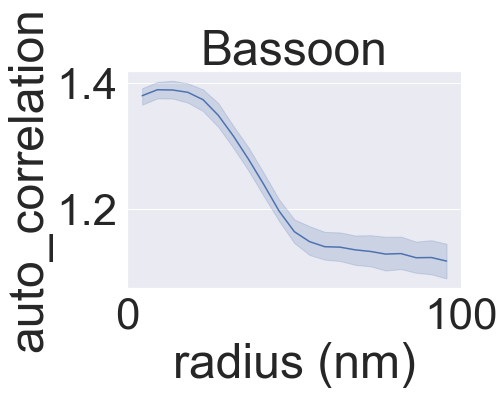

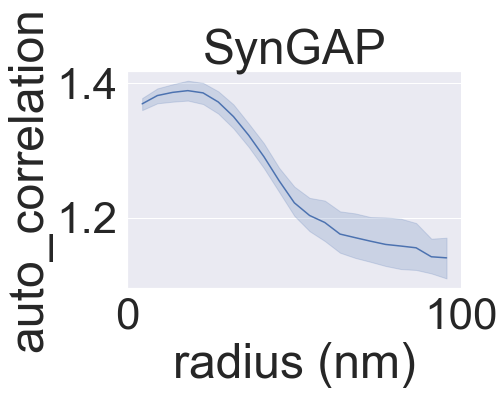

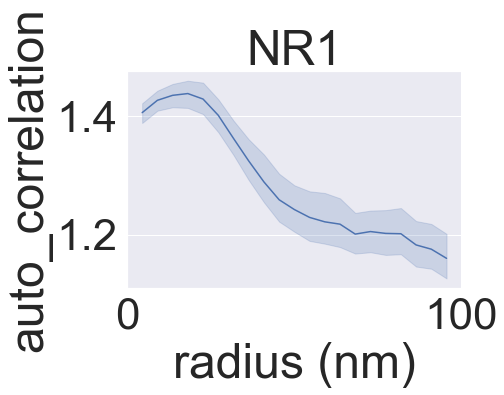

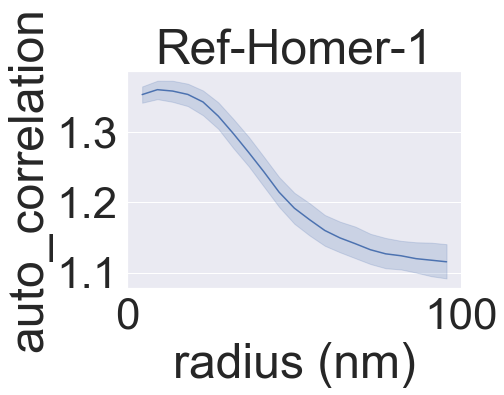

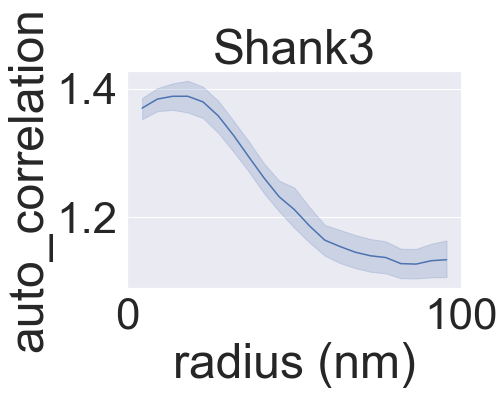

...

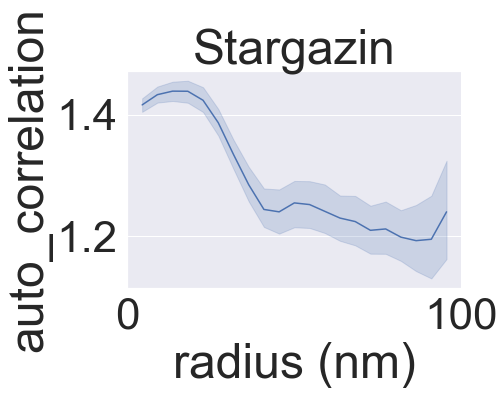

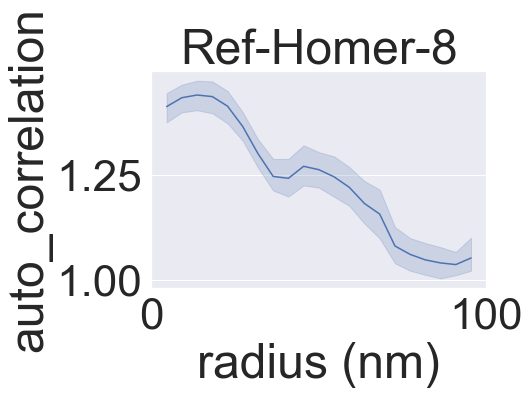

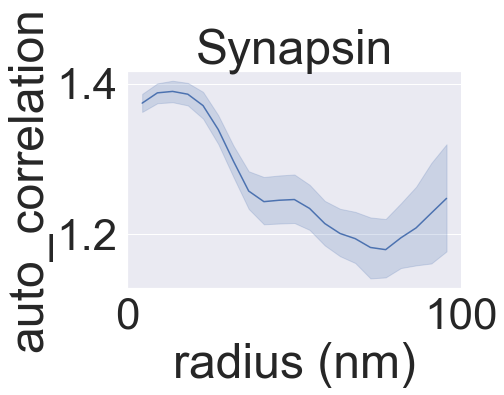

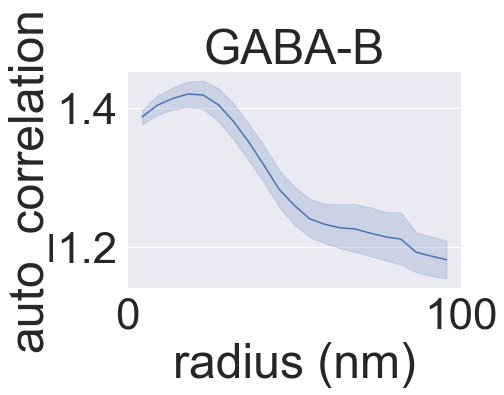

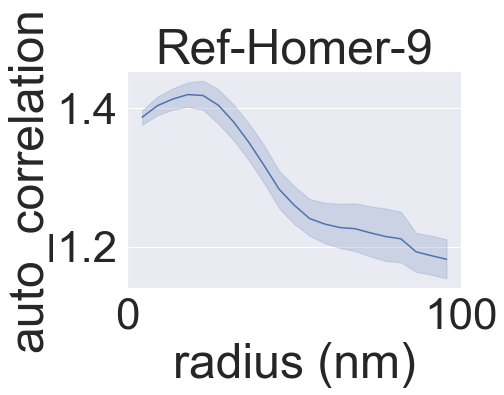

In [82]:
count = 0
for ch1 in range(1,nproteins+1):
    auto_datasub = auto_data[(auto_data['ch_1']==ch1)]
    auto_data_toplot = auto_datasub.drop(['ROI_no','synapse_no','ch_1','x_shift','y_shift','z_shift',
                               'avg_int_ch1','avg_int_ch2'],axis=1)
    auto_data_toplot.index=auto_data_toplot['synID']
    auto_data_toplot = auto_data_toplot.drop(['synID'],axis=1)
    melted = auto_data_toplot.melt(ignore_index=False)
    melted.rename(columns={"variable": "radius (pixels)", "value": "auto_correlation"},inplace=True)
    melted['radius (pixels)'] = melted['radius (pixels)'].astype(int)
    melted['auto_correlation'] = melted['auto_correlation'].astype(float)
    melted['radius (nm)'] = melted['radius (pixels)'] * (82/18)
    melted.reset_index(inplace=True)

    protein1 = channel_dict[ch1]

    fig,ax = plt.subplots(1)
    melted['protein'] = [protein1]*len(melted)
    ax = sns.lineplot(data=melted,x='radius (nm)',y='auto_correlation')
    ax.set_title(protein1)

    if count == 0:
        allauto_data = melted
        allauto_data['protein'] = [protein1]*len(melted)
    else:
        toadd = melted
        toadd['protein']= [protein1]*len(melted)
        allauto_data = pd.concat((allauto_data,toadd),axis=0)
    count = count + 1

In [83]:
allauto_data

,synID,radius (pixels),auto_correlation,radius (nm),protein
0,1.0-2.0,1,1.368181,4.555556,Bassoon
1,1.0-4.0,1,1.406951,4.555556,Bassoon
2,1.0-5.0,1,1.372211,4.555556,Bassoon
3,1.0-7.0,1,1.330394,4.555556,Bassoon
4,1.0-10.0,1,1.408508,4.555556,Bassoon
...,...,...,...,...,...
1045,5.0-6.0,21,1.224934,95.666667,Ref-Homer-9
1046,5.0-7.0,21,1.084820,95.666667,Ref-Homer-9
1047,5.0-8.0,21,1.174511,95.666667,Ref-Homer-9
1048,5.0-12.0,21,1.145664,95.666667,Ref-Homer-9


In [84]:
#exclude reference channel and proteins with poor staining
excludes=[]
for idx,row in allauto_data.iterrows():
    if 'Gephyrin' in row['protein']:
        excludes.append(False)
    elif 'Adam' in row['protein']:
        excludes.append(False)
    elif 'mGluR' in row['protein']:
        excludes.append(False)
    elif 'PSD95-6' in row['protein']:
        excludes.append(False)
    elif 'NR1-10' in row['protein']:
        excludes.append(False)
    elif 'Synapsin' in row['protein']:
        excludes.append(False)
    elif 'Synapto' in row['protein']:
        excludes.append(False)
    elif 'GluA4' in row['protein']:
        excludes.append(False)
    elif 'GABA-B' in row['protein']:
        excludes.append(False)
    elif 'Ref' in row['protein']:
        excludes.append(False)
    else:
        excludes.append(True)

In [85]:
allauto_data = allauto_data[excludes]

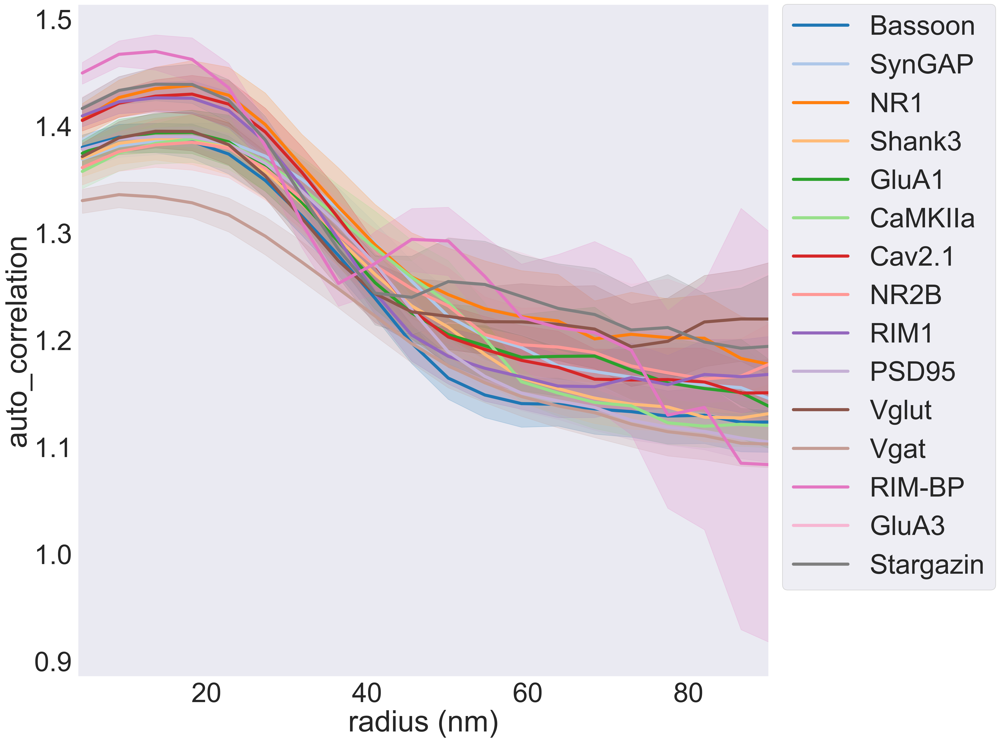

In [169]:
plt.figure(figsize=(20, 20))
sns.set(font_scale=4)
ax = sns.lineplot(data=allauto_data.reset_index(), x='radius (nm)', y='auto_correlation',
                  hue='protein', palette='tab20', legend='brief', linewidth=5)
legend = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
for line in legend.get_lines():
    line.set_linewidth(5)
ax.set_xlim(left=4, right=90)
ax.grid(False)
plt.savefig(parentdir + 'autocorrelation_curve_all.png', dpi=300, transparent=True, bbox_inches='tight')

## 2) Load and analyze protein enrichment data

In [91]:
nproteins = 30

In [92]:
os.listdir(parentdir)

['ROI5_AtoB_Enrichment_refAlign.txt',
 'autocorrelation_curve_non-reference.pdf',
 '.DS_Store',
 'archive',
 'autocorrelation_curve_non-reference.png',
 'ROI3_AtoB_Enrichment_refAlign.txt',
 'ROI2_AtoB_Enrichment_refAlign.txt',
 'enrichment_index_pairwise.csv',
 'ROI1_AtoB_Enrichment_refAlign.txt',
 'nanocolumn_rois_to_exclude.csv',
 'AutoCorrelation_ROI1.txt',
 'AutoCorrelation_ROI3.txt',
 'autocorrelation_curve_all.png',
 'nanocolumn_rois_to_exclude.xlsx',
 'AutoCorrelation_ROI2.txt',
 'autocorrelation_curve_reference.png',
 'AutoCorrelation_ROI5.txt',
 'AutoCorrelation_ROI4.txt',
 'ROI4_AtoB_Enrichment_refAlign.txt']

In [93]:
data1 = pd.read_csv(parentdir + 'ROI1_AtoB_Enrichment_refAlign.txt',sep='\t',header=None)
data2 = pd.read_csv(parentdir + 'ROI2_AtoB_Enrichment_refAlign.txt',sep='\t',header=None)
data3 = pd.read_csv(parentdir + 'ROI3_AtoB_Enrichment_refAlign.txt',sep='\t',header=None)
data4 = pd.read_csv(parentdir + 'ROI4_AtoB_Enrichment_refAlign.txt',sep='\t',header=None)
data5 = pd.read_csv(parentdir + 'ROI5_AtoB_Enrichment_refAlign.txt',sep='\t',header=None)

In [94]:
data2[0] = [2.0]*len(data2)
data3[0] = [3.0]*len(data3)
data4[0] = [4.0]*len(data4)
data5[0] = [5.0]*len(data5)

In [95]:
data1

,0,1,2,3,4,5,6,7,8,9,...,32,33,34,35,36,37,38,39,40,41
0,1.0,1.0,1.0,1.0,2.7155654e+00,2.5209622e+00,2.0524685e+00,1.6437425e+00,1.2114098e+00,9.3581322e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,1.0,1.0,2.0,1.8685625e+00,1.7721786e+00,1.5157093e+00,1.2638829e+00,1.0869491e+00,9.2465531e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,1.0,1.0,3.0,2.2078359e+00,2.1509283e+00,1.8385056e+00,1.5876101e+00,1.2933912e+00,1.0232181e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,1.0,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0737588e+00,9.5674530e-01,7.7632661e-01,5.4999104e-01,NaN,NaN,NaN,NaN,NaN,NaN
4,1.0,1.0,1.0,5.0,2.6124451e+00,2.4328514e+00,1.9967981e+00,1.6273508e+00,1.2261062e+00,9.2539172e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25915,1.0,20.0,36.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.1445331e+00,1.2007523e+00,1.0711590e+00,1.0849185e+00,1.0503301e+00,1.1461333e+00,1.1320031e+00,NaN,NaN,NaN
25916,1.0,20.0,36.0,33.0,NaN,NaN,NaN,9.8425750e-01,9.5087834e-01,1.0782995e+00,...,1.0475346e+00,1.0633547e+00,1.1018977e+00,1.1672281e+00,1.2240447e+00,1.2646531e+00,1.2213226e+00,1.0983499e+00,NaN,NaN
25917,1.0,20.0,36.0,34.0,2.4563644e+00,2.2289811e+00,1.7884620e+00,1.2896345e+00,9.1374754e-01,7.5482277e-01,...,1.0592666e+00,1.0307958e+00,9.9541446e-01,9.0366251e-01,8.6001743e-01,9.2455391e-01,9.5175345e-01,8.4878133e-01,NaN,NaN
25918,1.0,20.0,36.0,35.0,2.6385437e+00,2.3888818e+00,1.7963638e+00,1.2791422e+00,8.4560100e-01,7.5873726e-01,...,1.0518857e+00,1.0032770e+00,9.4360339e-01,8.1796345e-01,7.9327127e-01,8.9614117e-01,1.0937893e+00,9.3358782e-01,NaN,NaN


In [96]:
columns = ['ROI_no','synapse_no','ch_1','ch_2',
          '1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22',
          '23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38',]

In [97]:
data = pd.concat((data1,data2,data3,data4,data5), axis=0)
data.columns = columns
data.dropna(how='all',inplace=True,axis=1)

In [98]:
data['synID'] = data['ROI_no'].astype(str) + "-" + data['synapse_no'].astype(str)

In [99]:
data

,ROI_no,synapse_no,ch_1,ch_2,1,2,3,4,5,6,...,29,30,31,32,33,34,35,36,37,synID
0,1.0,1.0,1.0,1.0,2.7155654e+00,2.5209622e+00,2.0524685e+00,1.6437425e+00,1.2114098e+00,9.3581322e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
1,1.0,1.0,1.0,2.0,1.8685625e+00,1.7721786e+00,1.5157093e+00,1.2638829e+00,1.0869491e+00,9.2465531e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
2,1.0,1.0,1.0,3.0,2.2078359e+00,2.1509283e+00,1.8385056e+00,1.5876101e+00,1.2933912e+00,1.0232181e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
3,1.0,1.0,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0737588e+00,9.5674530e-01,7.7632661e-01,5.4999104e-01,NaN,NaN,NaN,NaN,NaN,1.0-1.0
4,1.0,1.0,1.0,5.0,2.6124451e+00,2.4328514e+00,1.9967981e+00,1.6273508e+00,1.2261062e+00,9.2539172e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22027,5.0,17.0,36.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0
22028,5.0,17.0,36.0,33.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0
22029,5.0,17.0,36.0,34.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0
22030,5.0,17.0,36.0,35.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0-17.0


In [101]:
data.reset_index(inplace=True)
del data['index']

inds_toexclude = []
for idx,row in rois_exclude.iterrows():
    roino = int(row['ROI'][3])
    synapseno = int(row['synapse_no'])
    inds_toexclude.extend(data[(data['ROI_no']==roino)&(data['synapse_no']==synapseno)].index)

In [103]:
inds_tokeep = data.index.difference(inds_toexclude)

In [104]:
inds_tokeep

Int64Index([  1296,   1297,   1298,   1299,   1300,   1301,   1302,   1303,
              1304,   1305,
            ...
            103670, 103671, 103672, 103673, 103674, 103675, 103676, 103677,
            103678, 103679],
           dtype='int64', length=64800)

In [105]:
data=data.loc[inds_tokeep,:]
data

,ROI_no,synapse_no,ch_1,ch_2,1,2,3,4,5,6,...,29,30,31,32,33,34,35,36,37,synID
1296,1.0,2.0,1.0,1.0,2.4701201e+00,2.3051419e+00,1.9674923e+00,1.6527903e+00,1.3087687e+00,1.0346121e+00,...,8.9706204e-01,8.3263610e-01,8.3018307e-01,8.9703599e-01,9.8590597e-01,9.6653399e-01,9.2108649e-01,9.3360382e-01,NaN,1.0-2.0
1297,1.0,2.0,1.0,2.0,1.8960141e+00,1.7966922e+00,1.6227795e+00,1.4316855e+00,1.2309140e+00,1.1993093e+00,...,8.7032284e-01,NaN,1.0099911e+00,9.4391421e-01,9.1433499e-01,9.4087926e-01,9.5592876e-01,9.5515858e-01,NaN,1.0-2.0
1298,1.0,2.0,1.0,3.0,NaN,NaN,6.8586873e-01,7.7331287e-01,8.2367556e-01,8.9858417e-01,...,8.4732133e-01,7.9259268e-01,8.3361661e-01,9.7253050e-01,9.7079777e-01,8.6873272e-01,8.0837730e-01,8.9702222e-01,NaN,1.0-2.0
1299,1.0,2.0,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,...,9.5233606e-01,9.9805110e-01,1.0245930e+00,9.6192809e-01,8.6582612e-01,8.1375555e-01,8.0811386e-01,8.8779931e-01,NaN,1.0-2.0
1300,1.0,2.0,1.0,5.0,1.0705703e+00,1.0699048e+00,1.0846604e+00,1.1451697e+00,1.1912725e+00,1.1608049e+00,...,9.3306924e-01,9.6731398e-01,9.6388245e-01,8.6674871e-01,8.1344262e-01,7.7564212e-01,NaN,NaN,NaN,1.0-2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103675,5.0,14.0,36.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,...,7.3609049e-01,6.8235050e-01,7.8050954e-01,7.9389224e-01,7.1872531e-01,7.0260750e-01,7.8098525e-01,NaN,NaN,5.0-14.0
103676,5.0,14.0,36.0,33.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0057069e+00,1.1118736e+00,1.1861530e+00,1.1836615e+00,1.1817896e+00,1.1185547e+00,1.0951719e+00,1.0578463e+00,NaN,5.0-14.0
103677,5.0,14.0,36.0,34.0,2.1785712e+00,2.0849767e+00,1.8666591e+00,1.6260822e+00,1.3646730e+00,1.1517735e+00,...,7.1147091e-01,7.8774165e-01,8.3054289e-01,7.9652524e-01,7.4613461e-01,7.5582374e-01,7.7808965e-01,NaN,NaN,5.0-14.0
103678,5.0,14.0,36.0,35.0,1.9821874e+00,1.9689219e+00,1.8160405e+00,1.6256296e+00,1.3943593e+00,1.1963837e+00,...,7.2070661e-01,8.0263332e-01,8.3689795e-01,7.8933285e-01,7.2814051e-01,7.8215101e-01,7.2899368e-01,NaN,NaN,5.0-14.0


Plot protein pairs separately

/var/folders/71/pthjj8vn7h9596hzsrwryp1w0000gn/T/ipykernel_56583/3340181620.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1)


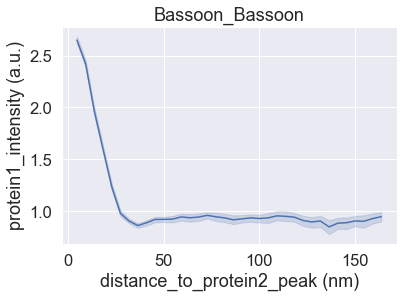

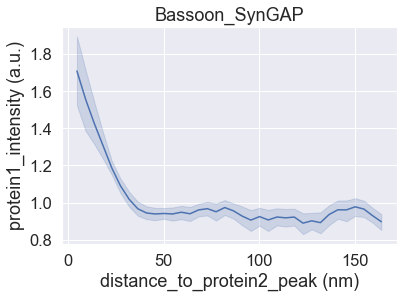

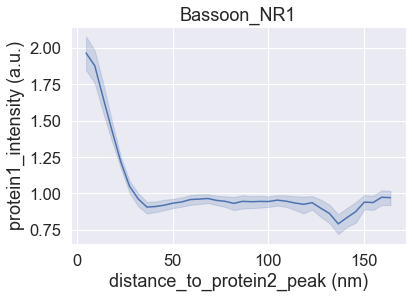

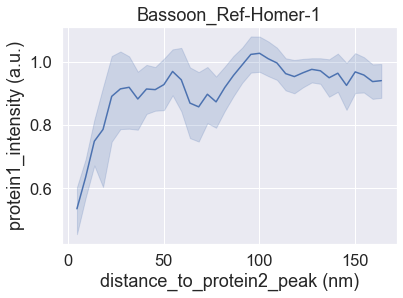

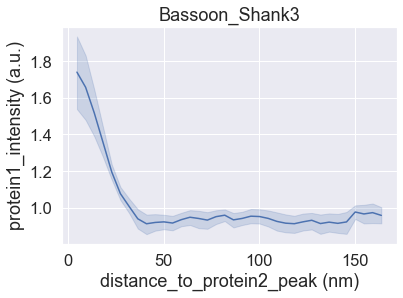

...

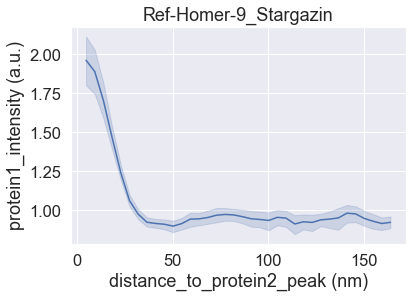

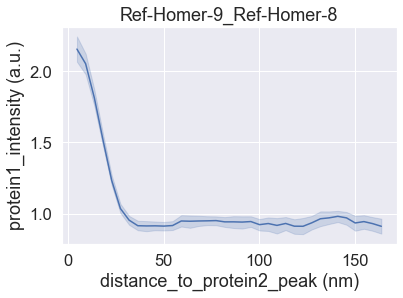

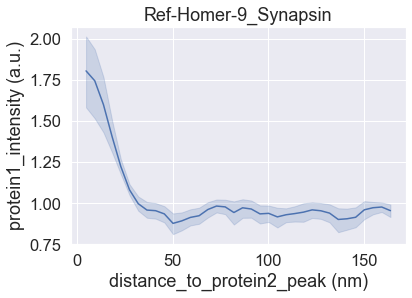

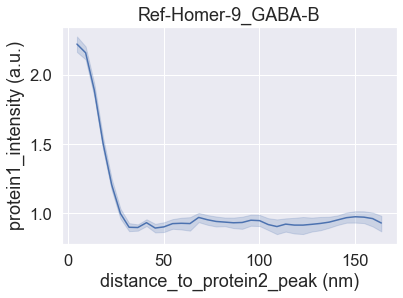

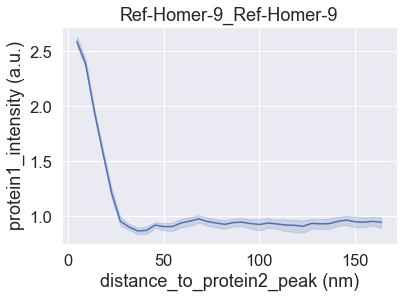

In [106]:
sns.set(font_scale = 1.5)
count = 0
for ch1 in range(1,nproteins+1):
    for ch2 in range(1,nproteins+1):
        #if ch1 != ch2:
            datasub = data[(data['ch_1']==ch1) & (data['ch_2']==ch2)]
            data_toplot = datasub.drop(['ROI_no','synapse_no','ch_1','ch_2'],axis=1)
            data_toplot.index=data_toplot['synID']
            data_toplot = data_toplot.drop(['synID'],axis=1)
            melted = data_toplot.melt(ignore_index=False)
            melted.rename(columns={"variable": "distance_to_protein2_peak (pixels)", "value": "protein1_intensity (a.u.)"},inplace=True)
            melted['distance_to_protein2_peak (pixels)'] = melted['distance_to_protein2_peak (pixels)'].astype(int)
            melted['distance_to_protein2_peak (nm)'] = melted['distance_to_protein2_peak (pixels)'] * (82/18)
            melted['protein1_intensity (a.u.)'] = melted['protein1_intensity (a.u.)'].astype(float)
            melted.reset_index(inplace=True)

            protein1 = channel_dict[ch1]
            protein2 = channel_dict[ch2]

            fig,ax = plt.subplots(1)
            pair = protein1+"_"+protein2
            melted['pair'] = [pair]*len(melted)
            ax = sns.lineplot(data=melted,x='distance_to_protein2_peak (nm)',y='protein1_intensity (a.u.)')
            ax.set_title(pair)

            if count == 0:
                alldata = melted
                alldata['pair'] = [pair]*len(melted)
            else:
                toadd = melted
                toadd['pair'] = [pair]*len(melted)
                alldata = pd.concat((alldata,toadd),axis=0)
            count = count + 1

In [107]:
alldata

,synID,distance_to_protein2_peak (pixels),protein1_intensity (a.u.),distance_to_protein2_peak (nm),pair
0,1.0-2.0,1,2.470120,4.555556,Bassoon_Bassoon
1,1.0-4.0,1,2.625522,4.555556,Bassoon_Bassoon
2,1.0-5.0,1,2.524157,4.555556,Bassoon_Bassoon
3,1.0-7.0,1,2.676304,4.555556,Bassoon_Bassoon
4,1.0-10.0,1,2.497447,4.555556,Bassoon_Bassoon
...,...,...,...,...,...
1845,5.0-6.0,37,NaN,168.555556,Ref-Homer-9_Ref-Homer-9
1846,5.0-7.0,37,NaN,168.555556,Ref-Homer-9_Ref-Homer-9
1847,5.0-8.0,37,NaN,168.555556,Ref-Homer-9_Ref-Homer-9
1848,5.0-12.0,37,NaN,168.555556,Ref-Homer-9_Ref-Homer-9


In [108]:
#Remove Gephyrin, Adam22, mGluR5, and reference channel from enrichment analysis
#These either didn't have good signal or aren't interesting from biological perspective
includes=[]
for idx,row in alldata.iterrows():
    if 'Gephyrin' in row['pair']:
        includes.append(False)
    elif 'Adam' in row['pair']:
        includes.append(False)
    elif 'mGluR' in row['pair']:
        includes.append(False)
    elif 'PSD95-6' in row['pair']:
        includes.append(False)
    elif 'NR1-10' in row['pair']:
        includes.append(False)
    elif 'Synapsin' in row['pair']:
        includes.append(False)
    elif 'Synapto' in row['pair']:
        includes.append(False)
    elif 'GluA4' in row['pair']:
        includes.append(False)
    elif 'GABA-B' in row['pair']:
        includes.append(False)
    elif 'Ref' in row['pair']:
        includes.append(False)
    else:
        includes.append(True)

alldata=alldata[includes]

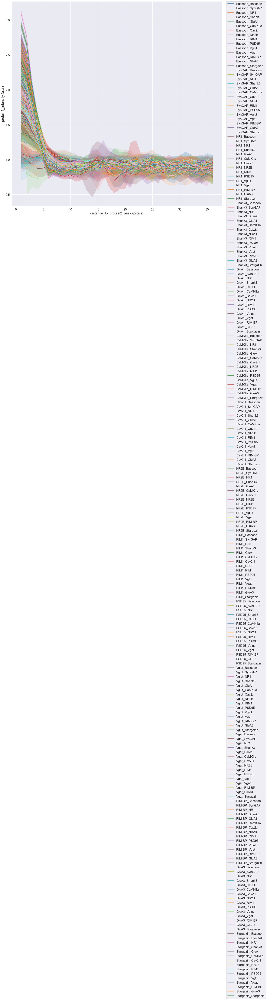

In [109]:
plt.figure(figsize = (20,20))
sns.set(font_scale = 1.5)
sns.lineplot(data=alldata.reset_index(),x='distance_to_protein2_peak (pixels)',y='protein1_intensity (a.u.)',
             hue='pair',palette='tab20',legend='brief')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# 3) Calculate the enrichment index

"To more easily compare the extent of the enrichment between these proteins in each layer, we also calculated the enrichment index, which is an average of all enrichment values within 60 nm (biological units) of the peak of a designated channel".\

In [110]:
unique_pairs = unique(list(alldata['pair']))

In [111]:
pair_names = []
pair_means = []
pair_sems = []
pair_counts = []

for pair in unique_pairs:
    temp = alldata[alldata['pair']==pair]
    subset = temp[temp['distance_to_protein2_peak (nm)'] <= 60].groupby('synID').mean()
    pair_mean = subset.mean()['protein1_intensity (a.u.)']
    pair_sem = subset.sem()['protein1_intensity (a.u.)']
    pair_count = subset.count()['protein1_intensity (a.u.)']
    
    pair_names.append(pair)
    pair_means.append(pair_mean)
    pair_sems.append(pair_sem)
    pair_counts.append(pair_count)

In [112]:
enrichment_index_df = pd.DataFrame(zip(pair_names,pair_means,pair_sems,pair_counts),
                                   columns=['pair_name','pair_ei_mean','pair_ei_sem','pair_ei_count'])

In [113]:
enrichment_index_df.sort_values(by='pair_name')

,pair_name,pair_ei_mean,pair_ei_sem,pair_ei_count
25,Bassoon_Bassoon,1.330392,0.006588,50
160,Bassoon_CaMKIIa,1.081095,0.025608,41
17,Bassoon_Cav2.1,1.149983,0.024027,45
37,Bassoon_GluA1,1.167396,0.028512,39
110,Bassoon_GluA3,1.214528,0.020886,46
...,...,...,...,...
107,Vglut_Shank3,1.143609,0.036904,43
169,Vglut_Stargazin,1.210431,0.028792,42
14,Vglut_SynGAP,1.139196,0.024025,46
82,Vglut_Vgat,1.089958,0.037694,36


In [114]:
os.getcwd()

'/Users/margaret/Dropbox (MIT)/mExR_analysis/Scripts/Python'

In [115]:
enrichment_index_df.to_csv(parentdir + 'enrichment_index_pairwise.csv',index=False)

In [116]:
prepost_dict = {
    'Bassoon':'pre',
     'Cav2.1':'pre',
     'RIM-BP':'pre',
 'RIM1':'pre',
 'Synapsin':'pre',
 'Vgat':'pre',
 'Vglut':'pre',
    
     'CaMKIIa':'post',
 'GABA-B':'post',
 'GluA1':'post',
 'GluA3':'post',
 'NR1':'post',
 'NR2B':'post',
 'PSD95':'post',
 'Shank3':'post',
 'Stargazin':'post',
 'SynGAP':'post'
}

In [117]:
pre_proteins = ['Bassoon',
     'Cav2.1',
     'RIM-BP',
 'RIM1',
 'Synapsin',
 'Vgat',
 'Vglut']

In [118]:
post_proteins = [
    'CaMKII',
 'GABA-B',
 'GluA1',
 'GluA3',
 'NR1',
 'NR2B',
 'PSD95',
 'Shank3',
 'Stargazin',
 'SynGAP'
]

In [119]:
#create a matrix to paste into Excel for colormapping

prots1=[]
prots2=[]

for idx,row in enrichment_index_df.iterrows():
    #print(row)
    prot1 = row['pair_name'].split("_")[0]
    prot2 = row['pair_name'].split("_")[-1]
    prots1.append(prot1)
    prots2.append(prot2)

In [120]:
enrichment_index_df['protein1']=prots1
enrichment_index_df['protein2']=prots2

In [121]:
proteins = unique(enrichment_index_df['protein1'])

In [122]:
proteins

['RIM-BP',
 'GluA1',
 'Cav2.1',
 'SynGAP',
 'GluA3',
 'PSD95',
 'Stargazin',
 'Vgat',
 'CaMKIIa',
 'Bassoon',
 'Shank3',
 'NR1',
 'RIM1',
 'Vglut',
 'NR2B']

In [123]:
enrichment_index_df

,pair_name,pair_ei_mean,pair_ei_sem,pair_ei_count,protein1,protein2
0,Cav2.1_Bassoon,1.130433,0.025557,42,Cav2.1,Bassoon
1,Vgat_Stargazin,1.262860,0.015271,44,Vgat,Stargazin
2,GluA1_RIM-BP,1.259989,0.020113,37,GluA1,RIM-BP
3,NR2B_Stargazin,1.231421,0.022268,41,NR2B,Stargazin
4,Cav2.1_NR2B,1.201380,0.023647,36,Cav2.1,NR2B
...,...,...,...,...,...,...
220,SynGAP_Vgat,1.096491,0.033742,37,SynGAP,Vgat
221,GluA3_RIM1,1.218409,0.024911,41,GluA3,RIM1
222,Stargazin_Shank3,1.151726,0.029553,40,Stargazin,Shank3
223,RIM-BP_NR1,1.135217,0.030242,40,RIM-BP,NR1


In [124]:
new_pairs = []
for idx,row in enrichment_index_df.iterrows():
    pair_name = row['protein1'] + '_' + row['protein2']
    new_pairs.append(pair_name)

In [125]:
enrichment_index_df['pair_name']=new_pairs

In [126]:
proteins.sort()

In [127]:
enrichment_index_df

,pair_name,pair_ei_mean,pair_ei_sem,pair_ei_count,protein1,protein2
0,Cav2.1_Bassoon,1.130433,0.025557,42,Cav2.1,Bassoon
1,Vgat_Stargazin,1.262860,0.015271,44,Vgat,Stargazin
2,GluA1_RIM-BP,1.259989,0.020113,37,GluA1,RIM-BP
3,NR2B_Stargazin,1.231421,0.022268,41,NR2B,Stargazin
4,Cav2.1_NR2B,1.201380,0.023647,36,Cav2.1,NR2B
...,...,...,...,...,...,...
220,SynGAP_Vgat,1.096491,0.033742,37,SynGAP,Vgat
221,GluA3_RIM1,1.218409,0.024911,41,GluA3,RIM1
222,Stargazin_Shank3,1.151726,0.029553,40,Stargazin,Shank3
223,RIM-BP_NR1,1.135217,0.030242,40,RIM-BP,NR1


In [128]:
unique(enrichment_index_df['protein1'])

['RIM-BP',
 'GluA1',
 'Cav2.1',
 'SynGAP',
 'GluA3',
 'PSD95',
 'Stargazin',
 'Vgat',
 'CaMKIIa',
 'Bassoon',
 'Shank3',
 'NR1',
 'RIM1',
 'Vglut',
 'NR2B']

In [129]:
#for now, restrict to pre-post pairs
preposts = []
for idx,row in enrichment_index_df.iterrows():
    prot1 = row['protein1']
    prot2 = row['protein2']
    prot1_ident = prepost_dict[prot1]
    prot2_ident = prepost_dict[prot2]
    if prot1_ident != prot2_ident:
        preposts.append(True)
    else:
        preposts.append(False)

In [130]:
enrichment_index_df['pre-post'] = preposts

In [131]:
#enrichment_index_df = enrichment_index_df[enrichment_index_df['pre-post']==True]

In [132]:
enrichment_index_df

,pair_name,pair_ei_mean,pair_ei_sem,pair_ei_count,protein1,protein2,pre-post
0,Cav2.1_Bassoon,1.130433,0.025557,42,Cav2.1,Bassoon,False
1,Vgat_Stargazin,1.262860,0.015271,44,Vgat,Stargazin,True
2,GluA1_RIM-BP,1.259989,0.020113,37,GluA1,RIM-BP,True
3,NR2B_Stargazin,1.231421,0.022268,41,NR2B,Stargazin,False
4,Cav2.1_NR2B,1.201380,0.023647,36,Cav2.1,NR2B,True
...,...,...,...,...,...,...,...
220,SynGAP_Vgat,1.096491,0.033742,37,SynGAP,Vgat,True
221,GluA3_RIM1,1.218409,0.024911,41,GluA3,RIM1,True
222,Stargazin_Shank3,1.151726,0.029553,40,Stargazin,Shank3,False
223,RIM-BP_NR1,1.135217,0.030242,40,RIM-BP,NR1,True


In [133]:
#exclude proteins with poor signal signal
#exclude Gephyrin because its not present at most synapses
excludes=[]
for idx,row in enrichment_index_df.iterrows():
    if 'Gephyrin' in row['protein1']:
        excludes.append(False)
    elif 'Adam' in row['protein1']:
        excludes.append(False)
    elif 'mGluR' in row['protein1']:
        excludes.append(False)
    elif 'PSD95-6' in row['protein1']:
        excludes.append(False)
    elif 'NR1-10' in row['protein1']:
        excludes.append(False)
    elif 'Synapsin' in row['protein1']:
        excludes.append(False)
    elif 'Synapto' in row['protein1']:
        excludes.append(False)
    elif 'GluA4' in row['protein1']:
        excludes.append(False)
    elif 'GABA-B' in row['protein1']:
        excludes.append(False)
    elif 'Ref' in row['protein1']:
        excludes.append(False)
    elif 'Gephyrin' in row['protein2']:
        excludes.append(False)
    elif 'Adam' in row['protein2']:
        excludes.append(False)
    elif 'mGluR' in row['protein2']:
        excludes.append(False)
    elif 'PSD95-6' in row['protein2']:
        excludes.append(False)
    elif 'NR1-10' in row['protein2']:
        excludes.append(False)
    elif 'Synapsin' in row['protein2']:
        excludes.append(False)
    elif 'Synapto' in row['protein2']:
        excludes.append(False)
    elif 'GluA4' in row['protein2']:
        excludes.append(False)
    elif 'GABA-B' in row['protein2']:
        excludes.append(False)
    elif 'Ref' in row['protein2']:
        excludes.append(False)
    else:
        excludes.append(True)

In [134]:
enrichment_index_df = enrichment_index_df[excludes]

In [135]:
proteins = unique(enrichment_index_df['protein1'])

In [136]:
enrichment_index_df['pair_name'].value_counts()

Cav2.1_Bassoon    1
PSD95_NR2B        1
GluA1_RIM1        1
RIM-BP_Shank3     1
GluA1_Shank3      1
                 ..
PSD95_PSD95       1
Vgat_RIM1         1
SynGAP_PSD95      1
Vglut_Vgat        1
GluA1_Bassoon     1
Name: pair_name, Length: 225, dtype: int64

In [137]:
enrich_matrix = np.zeros((len(proteins),len(proteins)))

In [138]:
enrichment_index_df

,pair_name,pair_ei_mean,pair_ei_sem,pair_ei_count,protein1,protein2,pre-post
0,Cav2.1_Bassoon,1.130433,0.025557,42,Cav2.1,Bassoon,False
1,Vgat_Stargazin,1.262860,0.015271,44,Vgat,Stargazin,True
2,GluA1_RIM-BP,1.259989,0.020113,37,GluA1,RIM-BP,True
3,NR2B_Stargazin,1.231421,0.022268,41,NR2B,Stargazin,False
4,Cav2.1_NR2B,1.201380,0.023647,36,Cav2.1,NR2B,True
...,...,...,...,...,...,...,...
220,SynGAP_Vgat,1.096491,0.033742,37,SynGAP,Vgat,True
221,GluA3_RIM1,1.218409,0.024911,41,GluA3,RIM1,True
222,Stargazin_Shank3,1.151726,0.029553,40,Stargazin,Shank3,False
223,RIM-BP_NR1,1.135217,0.030242,40,RIM-BP,NR1,True


In [139]:
for idx1,prot1 in enumerate(proteins):
    for idx2,prot2 in enumerate(proteins):
            subset = enrichment_index_df[enrichment_index_df['pair_name']==prot1+'_'+prot2]
            enrich_matrix[idx1,idx2]=subset['pair_ei_mean']

In [140]:
pd.DataFrame(enrich_matrix,columns=proteins,index=proteins).to_clipboard()

In [141]:
enrich_df = pd.DataFrame(enrich_matrix,columns=proteins,index=proteins)

In [142]:
proteins

['RIM-BP',
 'GluA1',
 'Cav2.1',
 'SynGAP',
 'GluA3',
 'PSD95',
 'Stargazin',
 'Vgat',
 'CaMKIIa',
 'Bassoon',
 'Shank3',
 'NR1',
 'RIM1',
 'Vglut',
 'NR2B']

Reorder the correlation matrix using this function: https://wil.yegelwel.com/cluster-correlation-matrix/

In [143]:
import scipy
import scipy.cluster.hierarchy as sch

def cluster_corr(corr_array, inplace=False):
    """
    Rearranges the correlation matrix, corr_array, so that groups of highly 
    correlated variables are next to eachother 
    
    Parameters
    ----------
    corr_array : pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix 
        
    Returns
    -------
    pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix with the columns and rows rearranged
    """
    pairwise_distances = sch.distance.pdist(corr_array)
    linkage = sch.linkage(pairwise_distances, method='complete')
    cluster_distance_threshold = pairwise_distances.max()/2
    idx_to_cluster_array = sch.fcluster(linkage, cluster_distance_threshold, 
                                        criterion='distance')
    idx = np.argsort(idx_to_cluster_array)
    
    if not inplace:
        corr_array = corr_array.copy()
    
    if isinstance(corr_array, pd.DataFrame):
        return corr_array.iloc[idx, :].T.iloc[idx, :]
    return corr_array[idx, :][:, idx]

In [144]:
plt.rcParams['figure.dpi'] = 300

<AxesSubplot:>

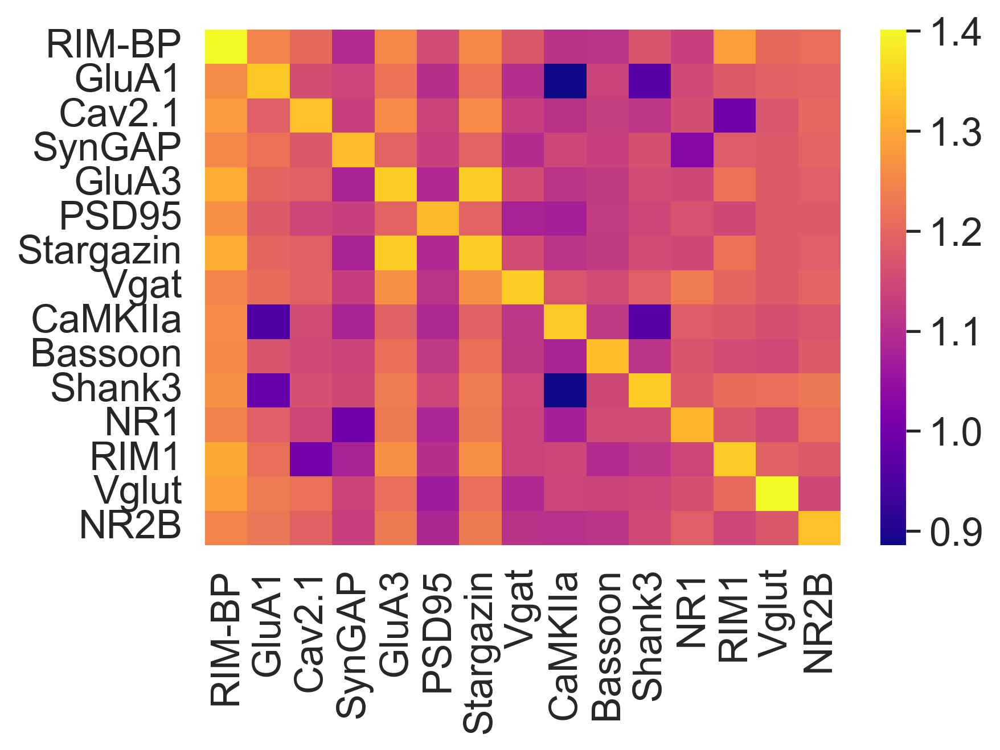

In [145]:
sns.heatmap(enrich_df,cmap='plasma',yticklabels=1,xticklabels=1)

In [146]:
reordered = cluster_corr(enrich_df)

<AxesSubplot:>

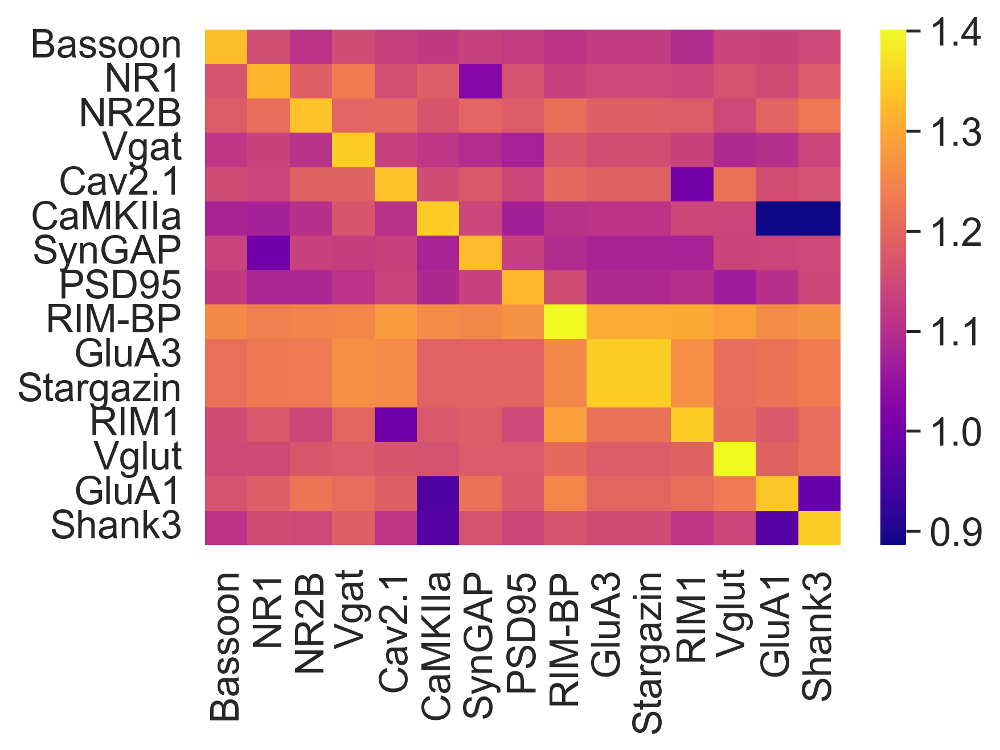

In [147]:
sns.heatmap(reordered,cmap='plasma',yticklabels=1,xticklabels=1)

In [151]:
len(unique(alldata['synID']))

50